In [2]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
import numpy as np
import os
from os.path import join, exists
import h5py
import matplotlib.pyplot as plt
import pandas as pd
import pickle as pkl
from tqdm import tqdm
from collections import defaultdict

# Assuming you have R2_score and r_score functions defined
# If not, here are simple implementations:
def R2_score(y_true, y_pred):
    """Calculate R-squared score"""
    ss_res = np.sum((y_true - y_pred) ** 2)
    ss_tot = np.sum((y_true - np.mean(y_true)) ** 2)
    return 1 - (ss_res / ss_tot) if ss_tot != 0 else 0

def r_score(y_true, y_pred):
    """Calculate Pearson correlation coefficient"""
    return np.corrcoef(y_true, y_pred)[0, 1] if len(y_true) > 1 else 0

In [4]:
basedir = f'/home/jovyan/work/DataLocal-w/Accentuate-VVS'

In [5]:
datafn = f'{basedir}/brain_data_control/vvs-accentuate_controlsessions_5monkeys_250504-250512.h5'


In [6]:
def h5_to_dict(h5_obj):
    out = {}
    for key, item in h5_obj.items():
        if isinstance(item, h5py.Group):
            out[key] = h5_to_dict(item)
        elif isinstance(item, h5py.Dataset):
            out[key] = item[()]  # Read the entire dataset
    return out

with h5py.File(datafn, 'r') as h5f:
    data_dict = h5_to_dict(h5f)

In [7]:
data_dict.keys()

dict_keys(['leap_250509-250512', 'paul_20250505-20250512', 'red_20250504-20250512', 'three0_250508-250512', 'venus_250507-250512'])

In [8]:

X = dict()

for monkey in data_dict.keys():
    
    stim_names = np.array(data_dict[monkey]['repavg']['stimulus_name'], dtype=str)
    resp = np.array(data_dict[monkey]['repavg']['response_peak'], dtype=float)
    monkey = monkey.split('_')[0]
    
    units = []
    for sn in stim_names:
        if 'unit' in sn:
            units.append(sn.split('unit')[1][1:].split('_')[0])
    units = np.unique(units)
    
    X[monkey] = dict()
    X[monkey]['model'] = []
    X[monkey]['channel'] = []
    X[monkey]['seed'] = []
    X[monkey]['target'] = []
    X[monkey]['score'] = []
    X[monkey]['resp'] = []
    X[monkey]['stim'] = []
    
    for unit in units:
        X[monkey][f'resp_unit_{unit}'] = []

    for s, stim in enumerate(stim_names):
        if 'score' in stim:
            X[monkey]['model'].append(stim.split('_RidgeCV')[0])
            this_chan = int(stim.split('_RidgeCV')[1].split('_')[2])
            X[monkey]['channel'].append(this_chan)
            X[monkey]['seed'].append(int(stim.split('_RidgeCV')[1].split('_')[4]))
            X[monkey]['target'].append(float(stim.split('_RidgeCV')[1].split('_')[6]))
            X[monkey]['score'].append(float(stim.split('_RidgeCV')[1].split('_')[8][:-4]))
            X[monkey]['resp'].append(resp[s,this_chan])
            for unit in units:
                X[monkey][f'resp_unit_{unit}'].append(resp[s,int(unit)])
            X[monkey]['stim'].append(stim)
    X[monkey] = pd.DataFrame(X[monkey])
    print(monkey, X[monkey].shape)


leap (2449, 12)
paul (5082, 12)
red (5475, 12)
three0 (3011, 12)
venus (5495, 12)


In [9]:
renamed_dfs = {}
for monkey, df in X.items():
    # rename all resp_unit* columns to resp_{monkey}_unit_*
    df_renamed = df.rename(
        columns={col: f"resp_{monkey}_{col.split('_', 1)[1]}"
                 for col in df.columns if col.startswith("resp_unit")}
    )
    # add monkey column
    df_renamed = df_renamed.assign(monkey=monkey)
    renamed_dfs[monkey] = df_renamed

# concatenate everything
combined = pd.concat(renamed_dfs.values(), ignore_index=True)

# move "monkey" to be the first column
cols = ["monkey"] + [c for c in combined.columns if c != "monkey"]
combined = combined[cols]

combined.to_csv("AccentuateVVS-5monkey-control-session-resps.csv", index=False)

In [10]:
combined

,monkey,model,channel,seed,target,score,resp,stim,resp_leap_unit_282,resp_leap_unit_286,...,resp_three0_unit_120,resp_three0_unit_168,resp_three0_unit_204,resp_three0_unit_56,resp_three0_unit_74,resp_venus_unit_151,resp_venus_unit_331,resp_venus_unit_355,resp_venus_unit_79,resp_venus_unit_9
0,leap,AlexNet_training_seed_01,282,0,-0.521408,-0.511481,-1.149563,AlexNet_training_seed_01_RidgeCV_unit_282_img_...,-1.149563,-1.348944,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,leap,AlexNet_training_seed_01,282,0,-2.175886,-2.165995,0.276993,AlexNet_training_seed_01_RidgeCV_unit_282_img_...,0.276993,-0.670149,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,leap,AlexNet_training_seed_01,282,0,2.236055,2.227143,0.571566,AlexNet_training_seed_01_RidgeCV_unit_282_img_...,0.571566,-0.282538,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,leap,AlexNet_training_seed_01,282,1,-1.624393,-1.614537,-0.414771,AlexNet_training_seed_01_RidgeCV_unit_282_img_...,-0.414771,0.083718,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,leap,AlexNet_training_seed_01,282,1,-2.175886,-2.166456,0.446391,AlexNet_training_seed_01_RidgeCV_unit_282_img_...,0.446391,0.015711,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21507,venus,siglip2_vitb16,9,9,1.062953,1.053078,0.891057,siglip2_vitb16_RidgeCV_unit_9_img_9_level_1.06...,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.901582,0.408374,1.046571,-0.690517,0.891057
21508,venus,siglip2_vitb16,9,9,1.557169,1.547310,0.942267,siglip2_vitb16_RidgeCV_unit_9_img_9_level_1.55...,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-1.101848,-0.161032,0.455749,-0.558501,0.942267
21509,venus,siglip2_vitb16,9,9,2.051386,1.922004,1.789834,siglip2_vitb16_RidgeCV_unit_9_img_9_level_2.05...,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.245390,0.894446,0.537747,-0.250843,1.789834
21510,venus,siglip2_vitb16,9,9,2.545602,1.847999,0.930203,siglip2_vitb16_RidgeCV_unit_9_img_9_level_2.54...,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-1.539028,-0.101540,-0.048939,-1.139615,0.930203


In [11]:
combined.to_csv("AccentuateVVS-5monkey-control-session-resps.csv", index=False)

In [12]:
for key in X[monkey]:
    print(key, len(X[monkey][key]))

model 5495
channel 5495
seed 5495
target 5495
score 5495
resp 5495
stim 5495
resp_unit_151 5495
resp_unit_331 5495
resp_unit_355 5495
resp_unit_79 5495
resp_unit_9 5495


In [13]:
X[monkey].iloc[0]['stim']

'AlexNet_training_seed_01_RidgeCV_unit_151_img_0_level_-0.34073078048229277_score_-0.33122867345809937.png'

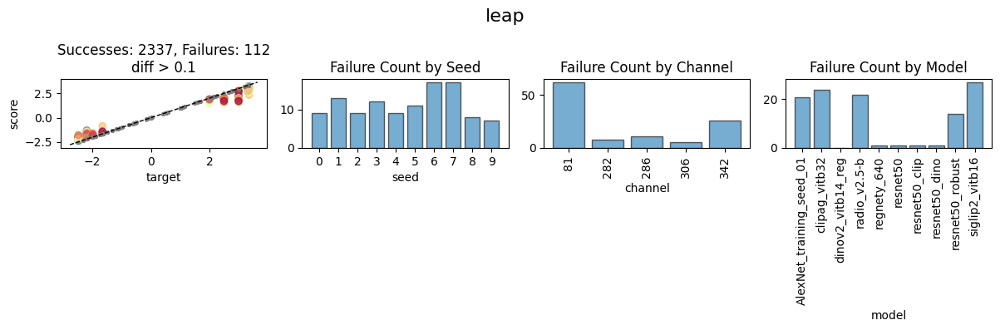

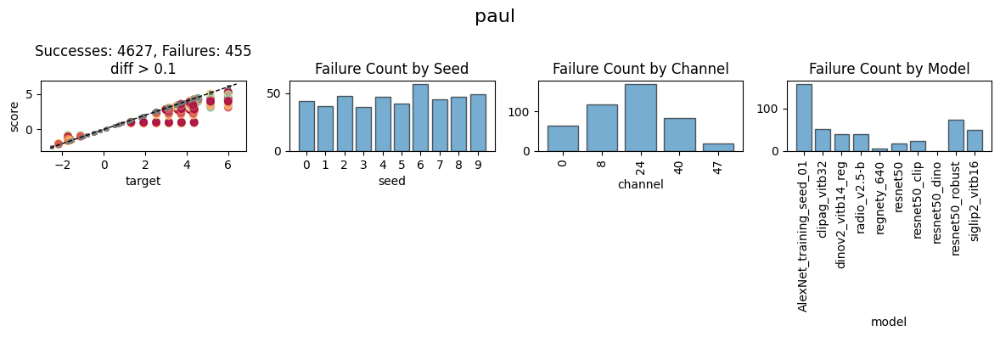

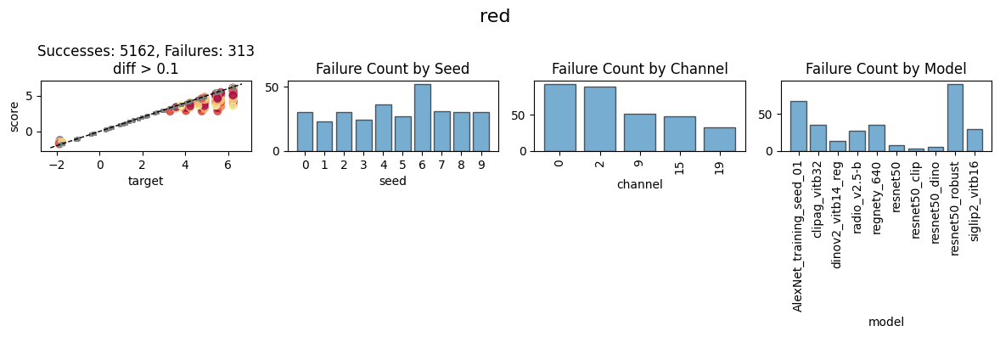

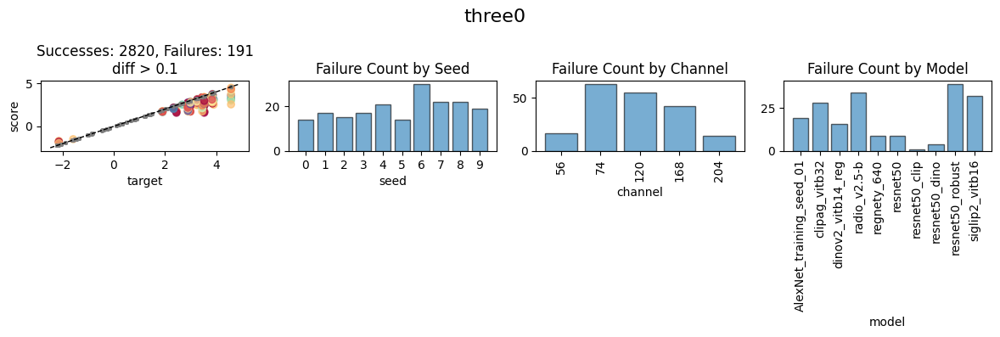

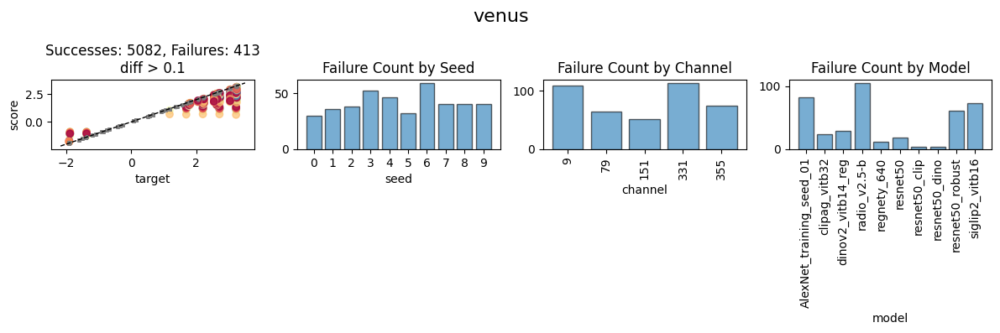

In [14]:
threshold = 0.1

for monkey in X.keys():
	# subset df for cases where target and score diverge by more than threshold
	X[monkey]['diff'] = X[monkey]['target'] - X[monkey]['score']
	subset = X[monkey][np.abs(X[monkey]['diff']) > threshold]
	non_subset = X[monkey][np.abs(X[monkey]['diff']) <= threshold]

	plt.figure(figsize=(12, 4))
 
	# supertitle with monkey name
	plt.suptitle(monkey, fontsize=16)

	# ── Subplot 1 ── (unchanged) ──
	ax1 = plt.subplot(1, 4, 1)
	ax1.scatter(subset['target'], subset['score'],
			c=subset['seed'], cmap='Spectral_r', alpha=0.7)

	mn, mx = min(*ax1.get_xlim(), *ax1.get_ylim()), max(*ax1.get_xlim(), *ax1.get_ylim())
	ax1.plot([mn, mx], [mn, mx], 'k--', lw=1)
	ax1.scatter(non_subset['target'], non_subset['score'],
			color='grey', alpha=0.2, s=5)
 
	# make title contain # successes and #  failures
	n_success = len(non_subset)
	n_failure = len(subset)
	ax1.set_title(f'Successes: {n_success}, Failures: {n_failure}\ndiff > {threshold}')
	ax1.set(xlabel='target', ylabel='score')


	# ── Subplot 2: Seeds as categorical bars ──
	ax2 = plt.subplot(1, 4, 2)
	seed_idx = np.arange(0, 10)  # 1 through 10
	seed_counts = subset['seed'].value_counts().reindex(seed_idx, fill_value=0)
	ax2.bar(seed_idx, seed_counts.values,
			width=0.8, edgecolor='black', alpha=0.6)
	ax2.set(xlabel='seed',
			xticks=seed_idx,
			title='Failure Count by Seed')


	# ── Subplot 3: Channels as categorical bars ──
	ax3 = plt.subplot(1, 4, 3)
	chan_vals = sorted(X[monkey]['channel'].unique())  # full set of channels
	chan_counts = subset['channel'].value_counts().reindex(chan_vals, fill_value=0)
	x_ch = np.arange(len(chan_vals))
	ax3.bar(x_ch, chan_counts.values,
			width=0.8, edgecolor='black', alpha=0.6)
	ax3.set(xlabel='channel',
			xticks=x_ch,
			xticklabels=chan_vals,
			title='Failure Count by Channel')
	plt.setp(ax3.get_xticklabels(), rotation=90)


	# ── Subplot 4: Models as categorical bars ──
	ax4 = plt.subplot(1, 4, 4)
	model_vals = X[monkey]['model'].unique()      # full set of models
	model_counts = subset['model'].value_counts().reindex(model_vals, fill_value=0)
	x_m = np.arange(len(model_vals))
	ax4.bar(x_m, model_counts.values,
			width=0.8, edgecolor='black', alpha=0.6)
	ax4.set(xlabel='model',
			xticks=x_m,
			xticklabels=model_vals,
			title='Failure Count by Model')
	plt.setp(ax4.get_xticklabels(), rotation=90)


	plt.tight_layout()
	plt.show()
 
 	# we will only analyze the subset of trials where target and score diverge by less than threshold
	X[monkey] = non_subset

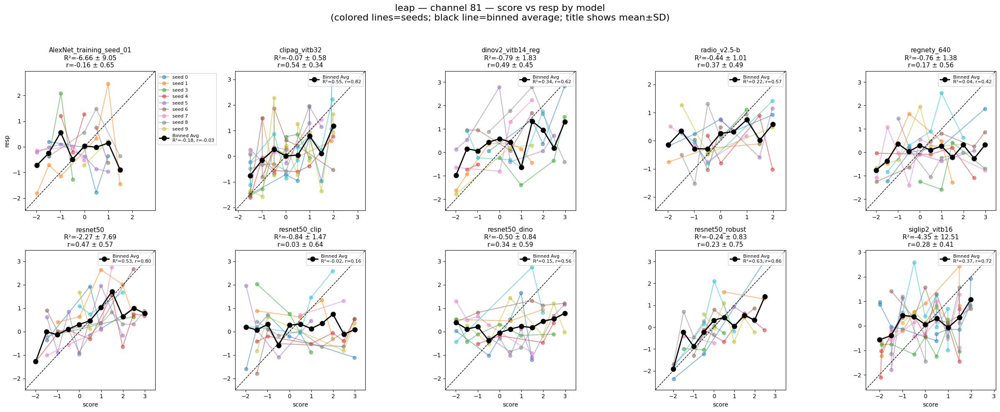

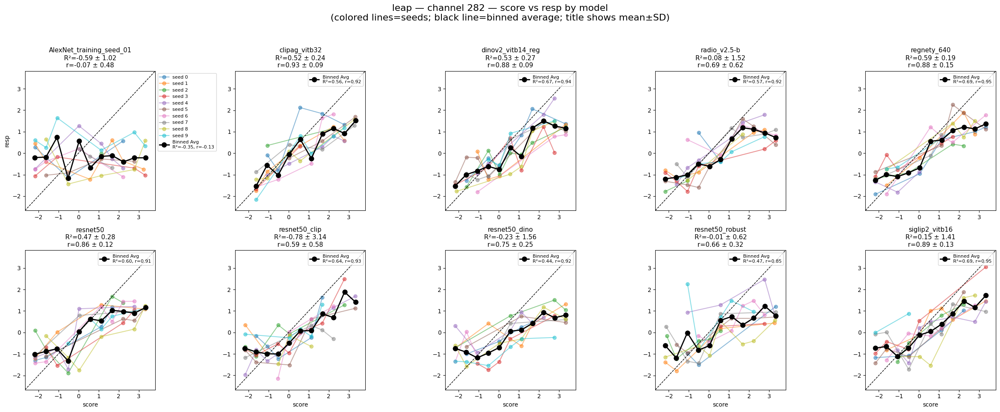

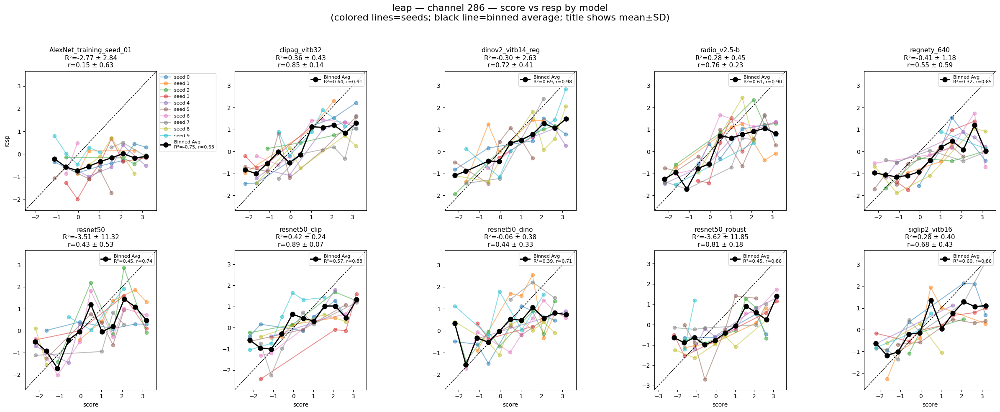

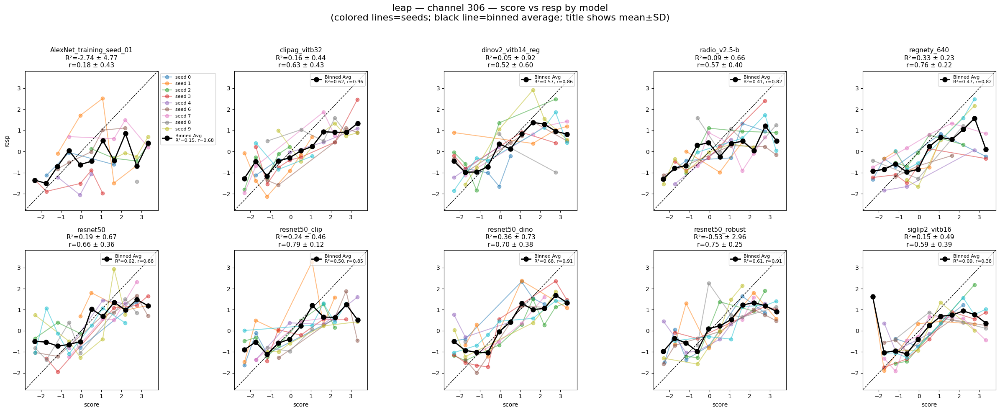

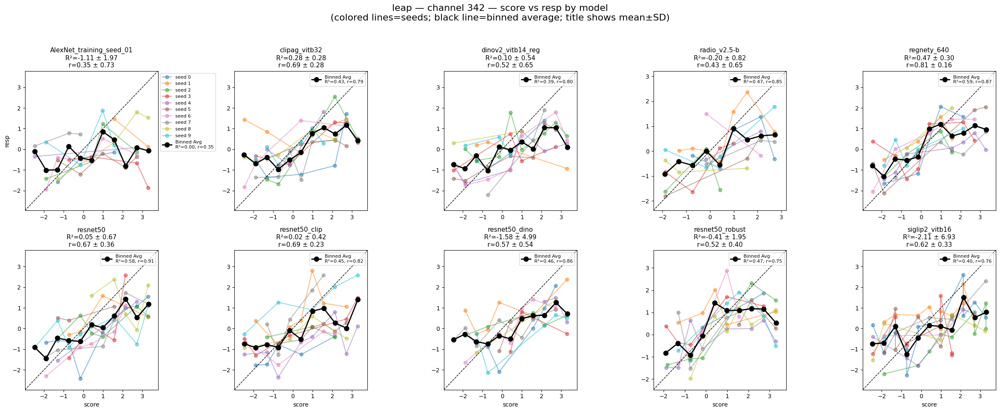

...

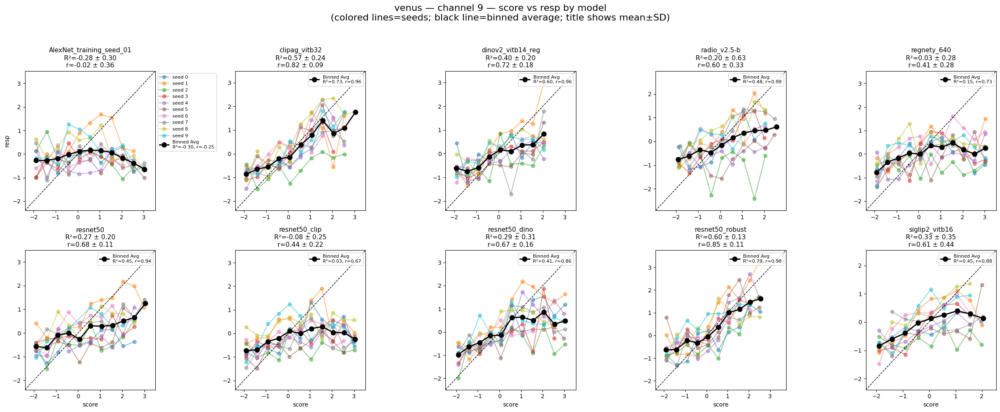

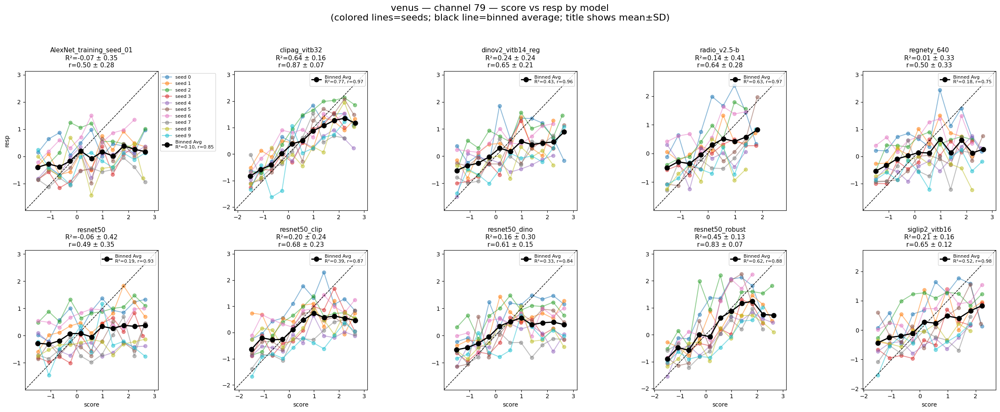

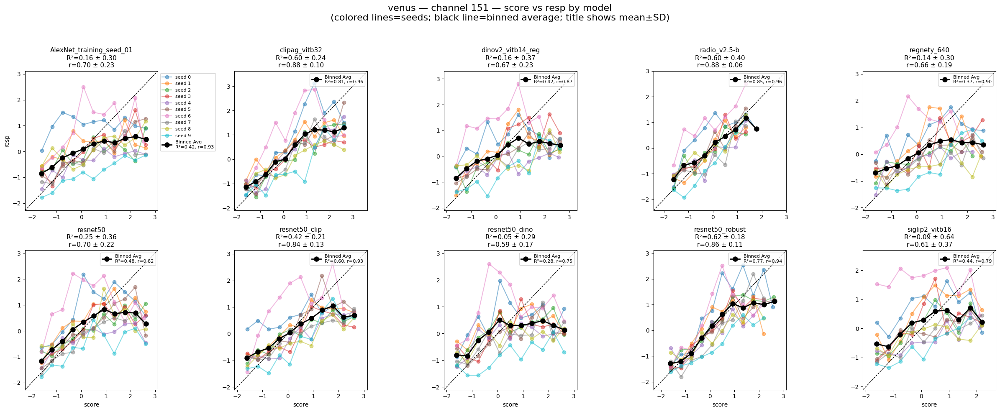

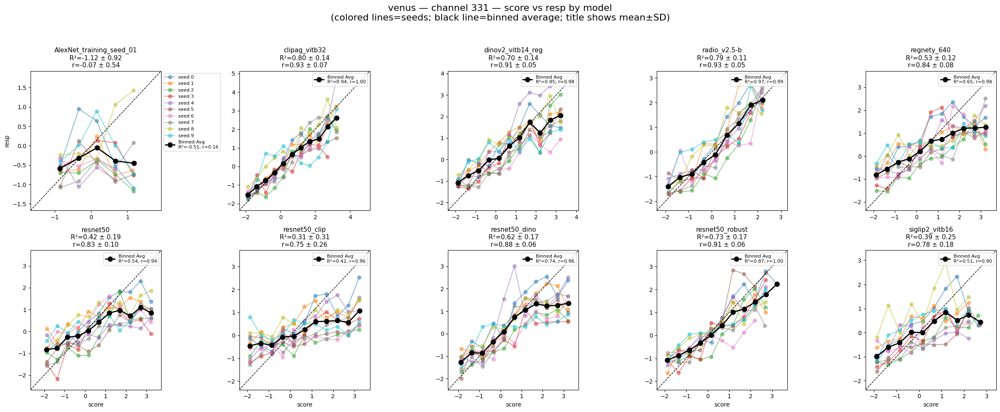

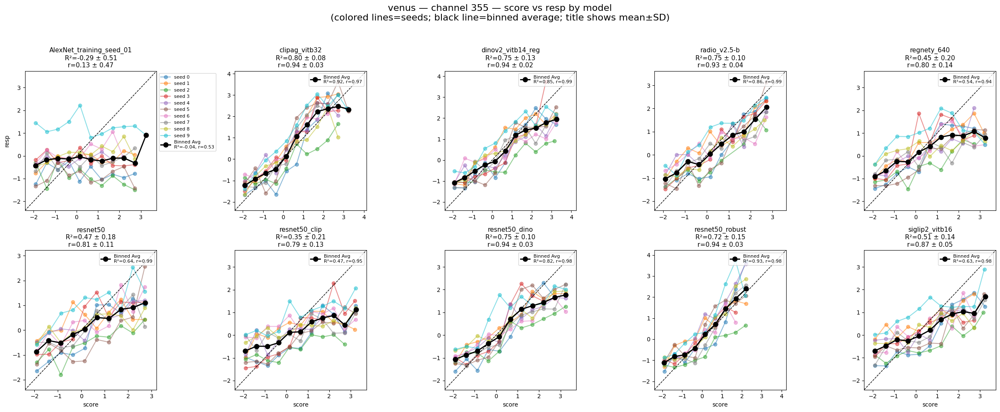

In [15]:
for monkey in X.keys():

    for channel in np.unique(X[monkey]['channel'].values):
        models = np.unique(X[monkey]['model'].values)
        seeds  = np.unique(X[monkey]['seed'].values)
        
        feat_levels = np.unique(
            X[monkey][X[monkey]['channel']==channel]['target'].values
        )
        assert len(feat_levels) == 11
        min_feat, max_feat = feat_levels.min(), feat_levels.max()

        # midpoints between each pair of levels
        mid_feat = np.array([
            (feat_levels[i] + feat_levels[i+1]) / 2
            for i in range(len(feat_levels)-1)
        ])

        # storage
        R2s, rs = {m:[] for m in models}, {m:[] for m in models}
        binned_R2s = {m:np.nan for m in models}
        binned_rs  = {m:np.nan for m in models}

        fig, axes = plt.subplots(2, 5, figsize=(24,10), sharex=False, sharey=False)
        axes = axes.flatten()

        for j, mdl in enumerate(models):
            ax = axes[j]
            all_scores, all_resps = [], []
            model_all_data = {'score':[], 'resp':[]}

            for sd in seeds:
                df_cs = X[monkey]
                df_cs = df_cs[
                    (df_cs['channel']==channel) &
                    (df_cs['seed']==sd) &
                    (df_cs['model']==mdl)
                ]
                if df_cs.empty:
                    R2s[mdl].append(np.nan)
                    rs[mdl].append(np.nan)
                    continue

                df_cs = df_cs.sort_values('score')
                all_scores += df_cs['score'].tolist()
                all_resps  += df_cs['resp'].tolist()
                model_all_data['score'] += df_cs['score'].tolist()
                model_all_data['resp']  += df_cs['resp'].tolist()

                r2 = R2_score(df_cs['score'], df_cs['resp'])
                r_ = r_score(df_cs['score'], df_cs['resp'])
                R2s[mdl].append(r2)
                rs[mdl].append(r_)

                ax.plot(
                    df_cs['score'], df_cs['resp'],
                    marker='o', alpha=0.5, label=f'seed {sd}'
                )

            # bin and average across all seeds
            if model_all_data['score']:
                scores = np.array(model_all_data['score'])
                resps  = np.array(model_all_data['resp'])
                # compute half‐gap midpoints and full bin edges
                mid_feat = (feat_levels[:-1] + feat_levels[1:]) / 2
                bin_edges = np.concatenate([
                    [feat_levels[0] - (mid_feat[0] - feat_levels[0])],
                    mid_feat,
                    [feat_levels[-1] + (feat_levels[-1] - mid_feat[-1])]
                ])

                binned_x, binned_y = [], []
                for k, center in enumerate(feat_levels):
                    left, right = bin_edges[k], bin_edges[k+1]
                    # for the last bin include the right edge
                    if k < len(feat_levels) - 1:
                        mask = (scores >= left) & (scores < right)
                    else:
                        mask = (scores >= left) & (scores <= right)
                    if np.any(mask):
                        binned_x.append(center)
                        binned_y.append(resps[mask].mean())

                # now plot if you have at least two bins
                if len(binned_x) >= 2:
                    binned_R2s[mdl] = R2_score(np.array(binned_x), np.array(binned_y))
                    binned_rs[mdl]  = r_score(np.array(binned_x), np.array(binned_y))
                    bin_label = f'Binned Avg\nR²={binned_R2s[mdl]:.2f}, r={binned_rs[mdl]:.2f}'
                    ax.plot(
                        binned_x, binned_y,
                        'k-', marker='o', linewidth=2, markersize=8,
                        label=bin_label
                    )

            # stats and 45° line
            mean_r2, std_r2 = np.nanmean(R2s[mdl]), np.nanstd(R2s[mdl], ddof=1)
            mean_r,  std_r  = np.nanmean(rs[mdl]),  np.nanstd(rs[mdl], ddof=1)
            mn = min(min(all_scores), min(all_resps))
            mx = max(max(all_scores), max(all_resps))
            ax.set(xlim=(mn-0.5, mx+0.5), ylim=(mn-0.5, mx+0.5))
            ax.plot([mn-0.5, mx+0.5], [mn-0.5, mx+0.5], 'k--', lw=1)

            ax.set_title(
                f"{mdl}\n"
                f"R²={mean_r2:.2f} ± {std_r2:.2f}\n"
                f"r={mean_r:.2f} ± {std_r:.2f}",
                fontsize=11
            )
            if j == 0:     ax.set_ylabel('resp')
            if j >= 5:     ax.set_xlabel('score')

            # legend: show all seeds on first, only binned on others
            if j == 0:
                ax.legend(fontsize=8, loc='upper left', bbox_to_anchor=(1,1))
            else:
                handles, labels = ax.get_legend_handles_labels()
                for idx, lbl in enumerate(labels):
                    if 'Binned Avg' in lbl:
                        ax.legend(
                            [handles[idx]], [labels[idx]],
                            fontsize=8, loc='upper right'
                        )
                        break

        # turn off extra axes
        for k in range(len(models), len(axes)):
            axes[k].axis('off')

        fig.suptitle(
            f"{monkey} — channel {channel} — score vs resp by model\n"
            "(colored lines=seeds; black line=binned average; title shows mean±SD)",
            fontsize=16
        )
        plt.tight_layout(rect=[0,0,1,0.95])
        plt.show()

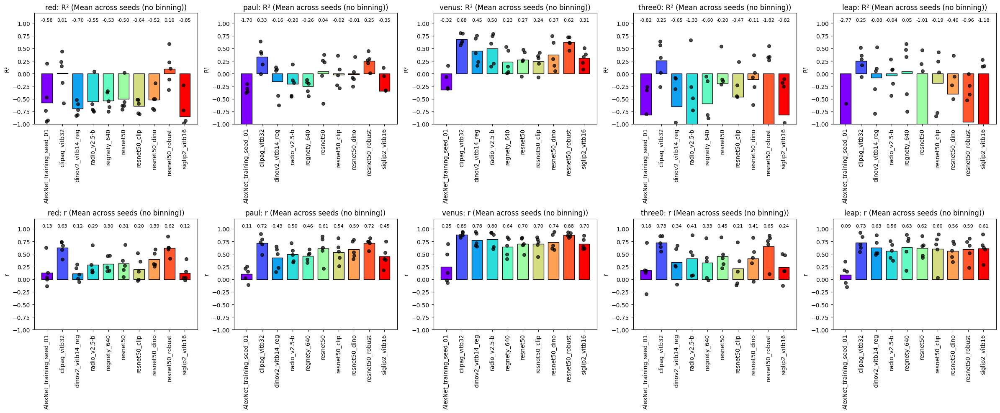

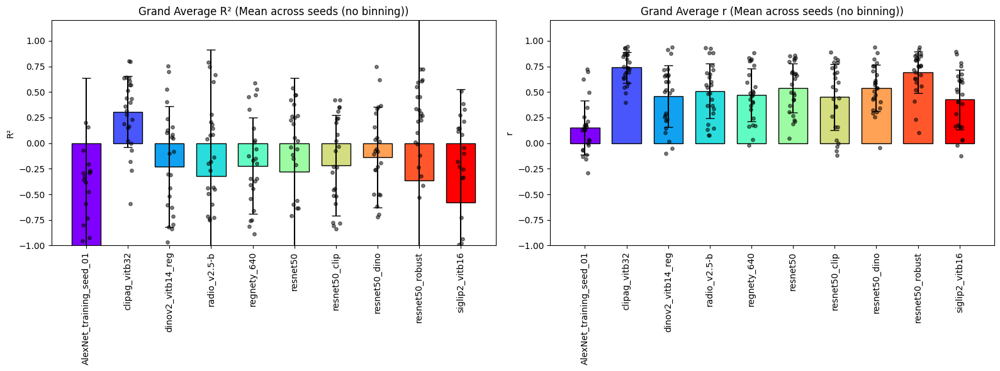

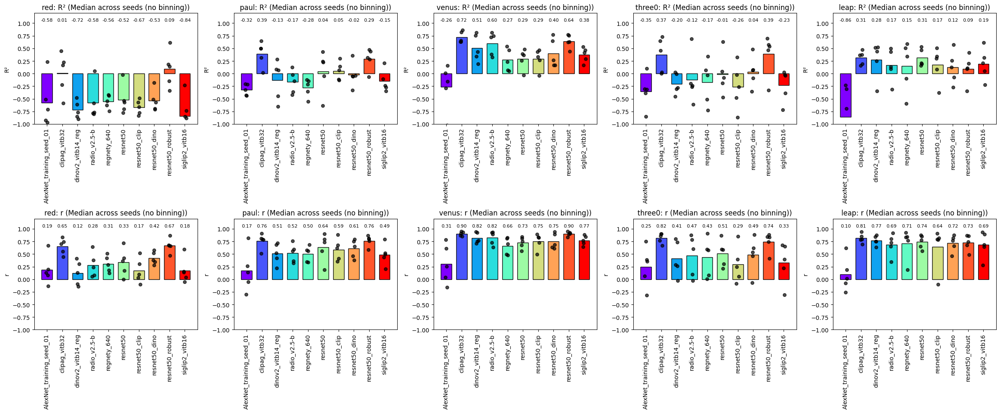

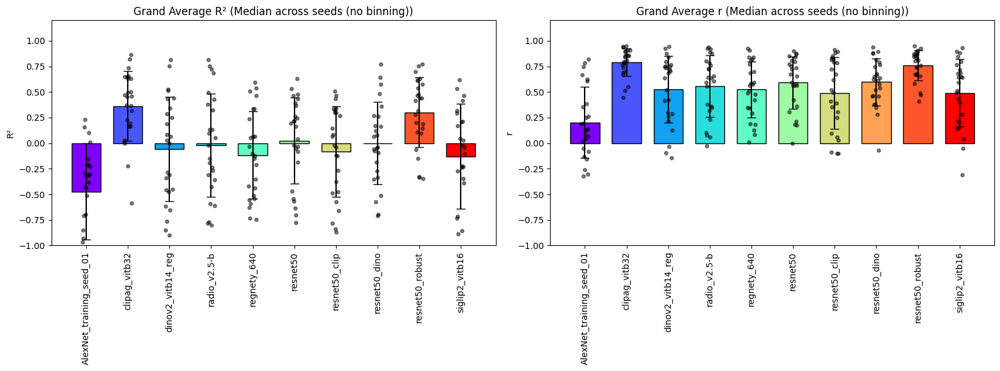

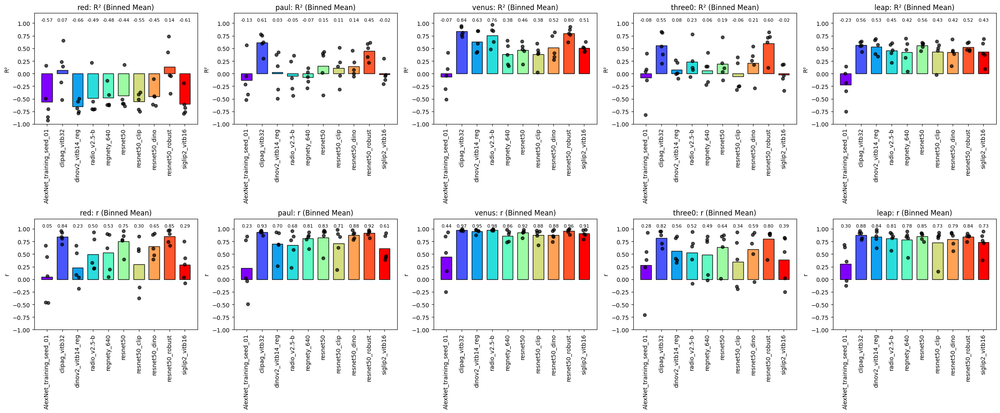

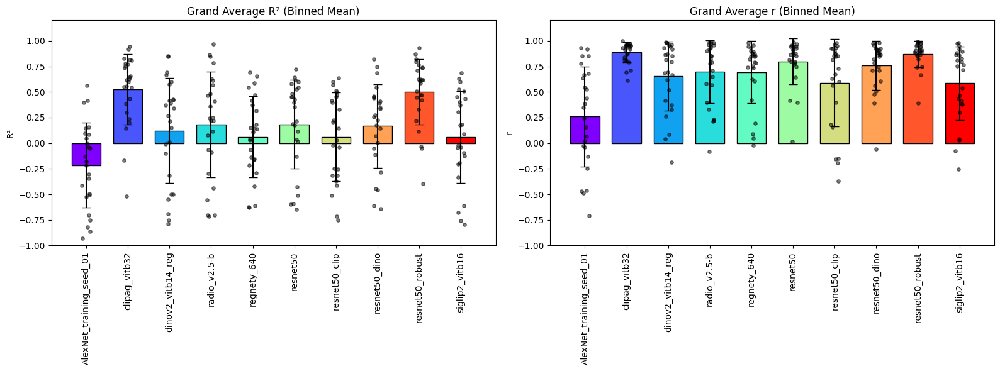

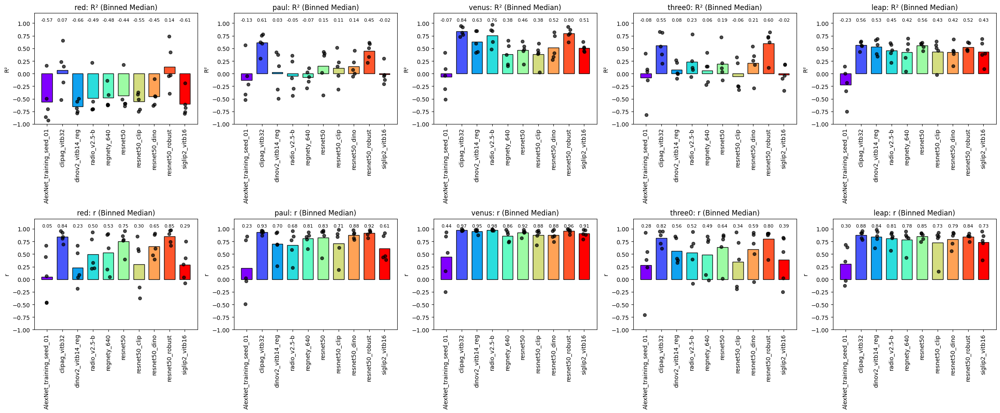

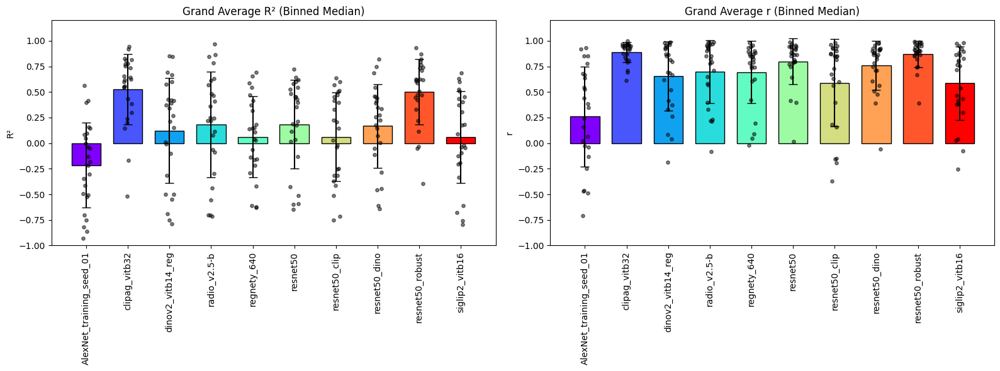

0.05

In [30]:
import numpy as np
import matplotlib.pyplot as plt

# ===============================================================
# Setup
# ===============================================================
monkeys    = ['red','paul','venus','three0','leap']
all_models = np.unique(np.concatenate([X[m]['model'].values for m in monkeys]))
cmap       = plt.get_cmap('rainbow')
cols       = cmap(np.linspace(0,1,len(all_models)))
model_colors = dict(zip(all_models, cols))
ylims_R2, ylims_r = (-1, 1.2), (-1, 1.2)

# ===============================================================
# Helper: compute R²/r per seed/channel/monkey/model
# ===============================================================
def compute_seed_level_corrs(X, monkeys, all_models, use_binned=False):
    """Return nested dict of per-seed R² and r values.
    If use_binned=True, reuse precomputed binned_R2/binned_r."""
    R2 = {m:{mdl:[] for mdl in all_models} for m in monkeys}
    r  = {m:{mdl:[] for mdl in all_models} for m in monkeys}

    for m in monkeys:
        df = X[m]
        channels = np.unique(df['channel'])
        models   = np.unique(df['model'])
        seeds    = np.unique(df['seed'])
        for ch in channels:
            for mdl in models:
                r2s, rs = [], []
                for sd in seeds:
                    sub = df[(df['channel']==ch) &
                             (df['model']==mdl) &
                             (df['seed']==sd)]
                    if sub.empty:
                        continue
                    if use_binned:
                        # fall back to binned results (already computed per channel)
                        continue  # handled later
                    r2s.append(R2_score(sub['score'].values, sub['resp'].values))
                    rs.append(r_score(sub['score'].values, sub['resp'].values))
                if not use_binned:
                    if r2s:
                        R2[m][mdl].append(r2s)
                        r[m][mdl].append(rs)
                    else:
                        R2[m][mdl].append([])
                        r[m][mdl].append([])
    return R2, r


# ===============================================================
# Helper: aggregate across seeds by mean or median
# ===============================================================
def aggregate_seed_level(R2_dict, r_dict, agg='mean'):
    """Aggregate per-seed lists (mean or median) into one value per channel."""
    out_R2 = {}
    out_r  = {}
    for m in R2_dict.keys():
        out_R2[m] = {}
        out_r[m]  = {}
        for mdl in R2_dict[m].keys():
            vals_R2 = []
            vals_r  = []
            for per_seed_R2, per_seed_r in zip(R2_dict[m][mdl], r_dict[m][mdl]):
                if len(per_seed_R2) == 0:
                    vals_R2.append(np.nan)
                    vals_r.append(np.nan)
                else:
                    if agg == 'mean':
                        vals_R2.append(np.nanmean(per_seed_R2))
                        vals_r.append(np.nanmean(per_seed_r))
                    else:
                        vals_R2.append(np.nanmedian(per_seed_R2))
                        vals_r.append(np.nanmedian(per_seed_r))
            out_R2[m][mdl] = vals_R2
            out_r[m][mdl]  = vals_r
    return out_R2, out_r


# ===============================================================
# Helper: plot per-monkey separate bar plots
# ===============================================================
def plot_per_monkey(R2_dict, r_dict, title_suffix, ylims_R2, ylims_r):
    fig, axes = plt.subplots(2, len(monkeys),
                             figsize=(24, 2*len(monkeys)),
                             sharey='col')
    if axes.ndim == 1:
        axes = axes[np.newaxis, :]

    for i, m in enumerate(monkeys):
        x = np.arange(len(all_models))

        # --- R² ---
        ax = axes[0, i]
        mean_R2 = [np.nanmean(R2_dict[m][mdl]) for mdl in all_models]
        bars = ax.bar(x, mean_R2,
                      color=[model_colors[mdl] for mdl in all_models],
                      edgecolor='black', width=0.7)
        for j, mdl in enumerate(all_models):
            yv = R2_dict[m][mdl]
            if len(yv) > 0:
                xj = j + np.random.uniform(-0.1, 0.1, size=len(yv))
                ax.scatter(xj, yv, color='black', s=30, alpha=0.7, zorder=3)
        for bar, val in zip(bars, mean_R2):
            ax.text(bar.get_x() + bar.get_width()/2, 1.02,
                    f"{val:.2f}", ha='center', va='bottom', fontsize=8)
        ax.set_xticks(x)
        ax.set_xticklabels(all_models, rotation=90)
        ax.set_ylabel('R²')
        ax.set_title(f"{m}: R² ({title_suffix})")
        ax.set_ylim(ylims_R2)

        # --- r ---
        ax = axes[1, i]
        mean_r = [np.nanmean(r_dict[m][mdl]) for mdl in all_models]
        bars = ax.bar(x, mean_r,
                      color=[model_colors[mdl] for mdl in all_models],
                      edgecolor='black', width=0.7)
        for j, mdl in enumerate(all_models):
            yv = r_dict[m][mdl]
            if len(yv) > 0:
                xj = j + np.random.uniform(-0.1, 0.1, size=len(yv))
                ax.scatter(xj, yv, color='black', s=30, alpha=0.7, zorder=3)
        for bar, val in zip(bars, mean_r):
            ax.text(bar.get_x() + bar.get_width()/2, 1.02,
                    f"{val:.2f}", ha='center', va='bottom', fontsize=8)
        ax.set_xticks(x)
        ax.set_xticklabels(all_models, rotation=90)
        ax.set_ylabel('r')
        ax.set_title(f"{m}: r ({title_suffix})")
        ax.set_ylim(ylims_r)

    plt.tight_layout()
    plt.show()


# ===============================================================
# Helper: plot grouped grand average with 25 dots
# ===============================================================
def plot_grand_average(R2_dict, r_dict, title_suffix, ylims_R2, ylims_r):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    x = np.arange(len(all_models))

    # --- R² ---
    grand_vals_R2 = {mdl: np.concatenate([R2_dict[m][mdl] for m in monkeys]) for mdl in all_models}
    grand_avg_R2 = [np.nanmean(grand_vals_R2[mdl]) for mdl in all_models]
    grand_std_R2 = [np.nanstd(grand_vals_R2[mdl], ddof=1) for mdl in all_models]

    bars1 = ax1.bar(x, grand_avg_R2, yerr=grand_std_R2, capsize=5,
                    color=[model_colors[mdl] for mdl in all_models],
                    edgecolor='black', width=0.7)
    for i, mdl in enumerate(all_models):
        vals = grand_vals_R2[mdl]
        xj = i + np.random.uniform(-0.1, 0.1, size=len(vals))
        ax1.scatter(xj, vals, color='black', s=15, alpha=0.5, zorder=3)
    ax1.set_xticks(x)
    ax1.set_xticklabels(all_models, rotation=90)
    ax1.set_ylabel('R²')
    ax1.set_ylim(ylims_R2)
    ax1.set_title(f"Grand Average R² ({title_suffix})")

    # --- r ---
    grand_vals_r = {mdl: np.concatenate([r_dict[m][mdl] for m in monkeys]) for mdl in all_models}
    grand_avg_r = [np.nanmean(grand_vals_r[mdl]) for mdl in all_models]
    grand_std_r = [np.nanstd(grand_vals_r[mdl], ddof=1) for mdl in all_models]

    bars2 = ax2.bar(x, grand_avg_r, yerr=grand_std_r, capsize=5,
                    color=[model_colors[mdl] for mdl in all_models],
                    edgecolor='black', width=0.7)
    for i, mdl in enumerate(all_models):
        vals = grand_vals_r[mdl]
        xj = i + np.random.uniform(-0.1, 0.1, size=len(vals))
        ax2.scatter(xj, vals, color='black', s=15, alpha=0.5, zorder=3)
    ax2.set_xticks(x)
    ax2.set_xticklabels(all_models, rotation=90)
    ax2.set_ylabel('r')
    ax2.set_ylim(ylims_r)
    ax2.set_title(f"Grand Average r ({title_suffix})")

    plt.tight_layout()
    plt.show()


# ===============================================================
# === RUN ALL FOUR VARIANTS === (mean + median, non-binned)
# ===============================================================
seed_R2, seed_r = compute_seed_level_corrs(X, monkeys, all_models, use_binned=False)

# Mean
R2_mean, r_mean = aggregate_seed_level(seed_R2, seed_r, agg='mean')
plot_per_monkey(R2_mean, r_mean, "Mean across seeds (no binning)", ylims_R2, ylims_r)
plot_grand_average(R2_mean, r_mean, "Mean across seeds (no binning)", ylims_R2, ylims_r)

# Median
R2_med, r_med = aggregate_seed_level(seed_R2, seed_r, agg='median')
plot_per_monkey(R2_med, r_med, "Median across seeds (no binning)", ylims_R2, ylims_r)
plot_grand_average(R2_med, r_med, "Median across seeds (no binning)", ylims_R2, ylims_r)

# ===============================================================
# === RUN ALL FOUR VARIANTS === (mean + median, binned)
# ===============================================================
# assumes binned_R2, binned_r already exist from your earlier code
# they are already per-channel; no seeds dimension

def aggregate_binned(binned_R2, binned_r, agg='mean'):
    R2, r = {}, {}
    for m in monkeys:
        R2[m], r[m] = {}, {}
        for mdl in all_models:
            vals_R2 = np.array(binned_R2[m][mdl])
            vals_r  = np.array(binned_r[m][mdl])
            if agg == 'mean':
                R2[m][mdl] = vals_R2[~np.isnan(vals_R2)].tolist()
                r[m][mdl]  = vals_r[~np.isnan(vals_r)].tolist()
            else:
                R2[m][mdl] = vals_R2[~np.isnan(vals_R2)].tolist()
                r[m][mdl]  = vals_r[~np.isnan(vals_r)].tolist()
    return R2, r

# Mean (binned)
R2_bmean, r_bmean = aggregate_binned(binned_R2, binned_r, agg='mean')
plot_per_monkey(R2_bmean, r_bmean, "Binned Mean", ylims_R2, ylims_r)
plot_grand_average(R2_bmean, r_bmean, "Binned Mean", ylims_R2, ylims_r)

# Median (binned)
R2_bmed, r_bmed = aggregate_binned(binned_R2, binned_r, agg='median')
plot_per_monkey(R2_bmed, r_bmed, "Binned Median", ylims_R2, ylims_r)
plot_grand_average(R2_bmed, r_bmed, "Binned Median", ylims_R2, ylims_r)
0.05